In [1]:
#@title Import Library

from __future__ import print_function, division
import time
import os
import copy
import numpy as np
import matplotlib as mpl
from matplotlib import pyplot as plt

# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.optim import lr_scheduler
# import torchvision
# from torchvision import datasets, models, transforms

from scipy.stats import zscore
from scipy.stats import spearmanr
from scipy.stats import pearsonr
from scipy.spatial.distance import pdist, squareform

from sklearn.decomposition import PCA, KernelPCA
from sklearn.manifold import TSNE

from PIL import Image  

In [2]:
#@title Figure Settings

%matplotlib inline
%config InlineBackend.figure_format='retina'
plt.ion()   # interactive mode

mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['lines.linewidth'] = 3
mpl.rcParams['legend.frameon'] = False
mpl.rcParams['axes.titlesize'] = 18
mpl.rcParams['axes.labelsize'] = 16
mpl.rcParams['figure.figsize'] = (8, 6)

# 现在我们加载fMRI数据
因为比较小，我们直接读，不存在网盘
这里的labels是NMA mentors用NN预测出来的，我们用自己的labels

In [3]:
fname = "kay_labels.npy"
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/r638s/download
fname = "kay_labels_val.npy"
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/yqb3e/download
fname = "kay_images.npz"
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/ymnjv/download

In [4]:
with np.load(fname) as dobj:
    dat = dict(**dobj)

In [5]:
data_dir = 'stimuli'
categories = os.listdir(data_dir)
#categories.remove('.ipynb_checkpoints',0)
categories

['inanimate_natural',
 'inanimate_artificial',
 'animate_animals',
 'animate_human']

In [6]:
training_data = [0] * 1750 
training_labels = [0] * 1750 
training_labels_name = [0] * 1750 
labels2num = {str(categories[i]): i for i in range(len(categories))}

for category in categories:
    files = os.listdir(data_dir+'//' + category)
    for file in files:
        training_index = int(file.split("_")[0])
        #im = Image.open(data_dir + '//' + category + '//' + file)
        #training_data[training_index] = np.array(im)
        training_labels[training_index] = labels2num[category]
        training_labels_name[training_index] = category

#training_data = np.array(training_data)
training_labels = np.array(training_labels)

In [7]:
labels2num

{'inanimate_natural': 0,
 'inanimate_artificial': 1,
 'animate_animals': 2,
 'animate_human': 3}

## BOLD信号

In [8]:
print(dat.keys())
print(dat["responses"].shape)
print(dat['roi'].shape)
print(dat['roi_names'])

dict_keys(['stimuli', 'stimuli_test', 'responses', 'responses_test', 'roi', 'roi_names'])
(1750, 8428)
(8428,)
['Other' 'V1' 'V2' 'V3' 'V3A' 'V3B' 'V4' 'LatOcc']


In [9]:
V1_response = dat["responses"][:,dat['roi'] == 1]
V2_response = dat["responses"][:,dat['roi'] == 2]
V3_response = dat["responses"][:,dat['roi'] == 3]
V3A_response = dat["responses"][:,dat['roi'] == 4]
V3B_response = dat["responses"][:,dat['roi'] == 5]
V4_response = dat["responses"][:,dat['roi'] == 6]
LatOcc_response = dat["responses"][:,dat['roi'] == 7]

## RSA分析

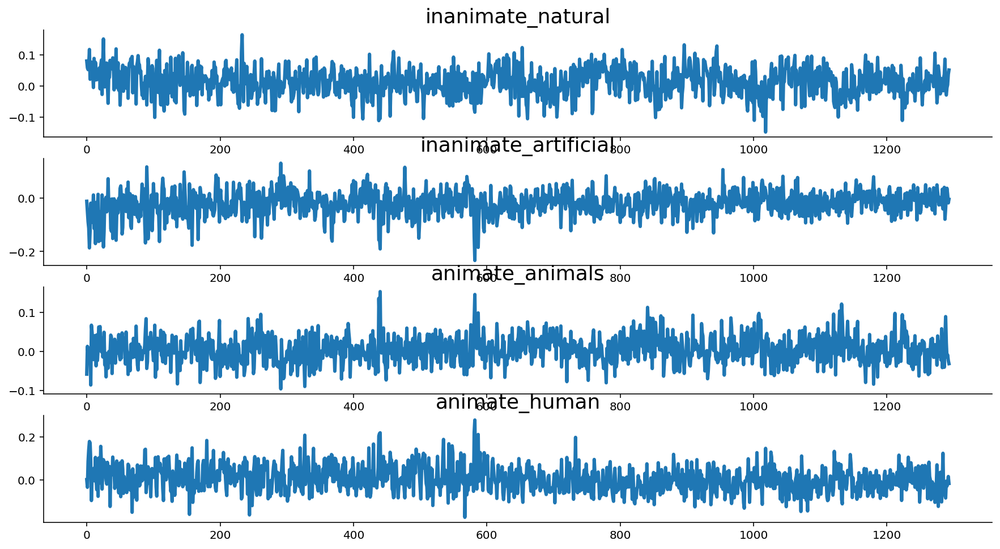

In [10]:
#@title plot stimulus-average response
V1_avg = np.zeros([4, V1_response.shape[1]])

fig, axes = plt.subplots(4, 1,figsize=[15, 8])
for i in range(4):
    V1_avg[i] = np.mean(V1_response[np.array(training_labels)==i], axis=0)
    axes[i].plot(V1_avg[i])
    axes[i].set_title(categories[i])

In [11]:
def avg_resp(resp, catag=4):
    resp_avg = np.zeros([catag, resp.shape[1]])
    for i in range(catag):
        resp_avg[i] = np.mean(resp[np.array(training_labels)==i], axis=0)   
    return resp_avg

V1_avg = avg_resp(V1_response)
V2_avg = avg_resp(V2_response)
V3_avg = avg_resp(V3_response)
V3A_avg = avg_resp(V3A_response)
V3B_avg = avg_resp(V3B_response)
V4_avg = avg_resp(V4_response)
LatOcc_avg = avg_resp(LatOcc_response)

## TSNE 做聚类

In [12]:
def plot_dim_reduction(resp, stim, ax=None):
    """Plot dimensionality-reduced population responses (using tSNE)

    Args:
      resp (numpy array): n_stimuli x n_neurons matrix with population responses
      ori (numpy array): 1D array of length stimuli with orientations of each
        stimulus, in radians
      ax (matplotlib axes): axes onto which to plot

    """
    if ax is None:
        ax = plt.gca()

    # First do PCA to reduce dimensionality to 200 dimensions so that tSNE is faster
    resp_lowd = PCA(n_components=min(300, resp.shape[1])).fit_transform(resp)

    # Then do tSNE to reduce dimensionality to 2 dimensions
    resp_lowd = TSNE(n_components=2, perplexity=30, n_jobs=-1).fit_transform(resp_lowd)

    # Plot dimensionality-reduced population responses
    # on 2D axes, with each point colored by stimulus orientation
    scat = ax.scatter(resp_lowd[:, 0], resp_lowd[:, 1], c=stim, cmap='magma')

    cbar = plt.colorbar(scat, ax=ax, label='stimulus categories', ticks=np.unique(training_labels))
    cbar.ax.set_yticklabels(['natural', 'artificial', 'animals', 'human'])
    ax.set_xlabel('dimension 1')
    ax.set_ylabel('dimension 2')
    ax.set_xticks([])
    ax.set_yticks([])

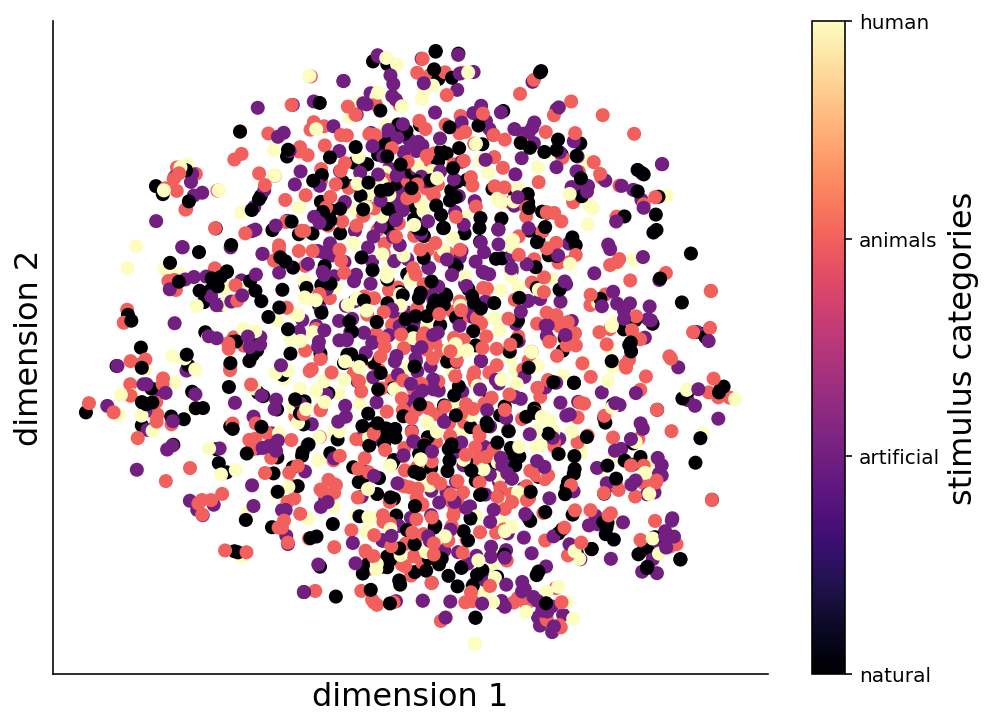

In [13]:
plot_dim_reduction(V1_response, training_labels)

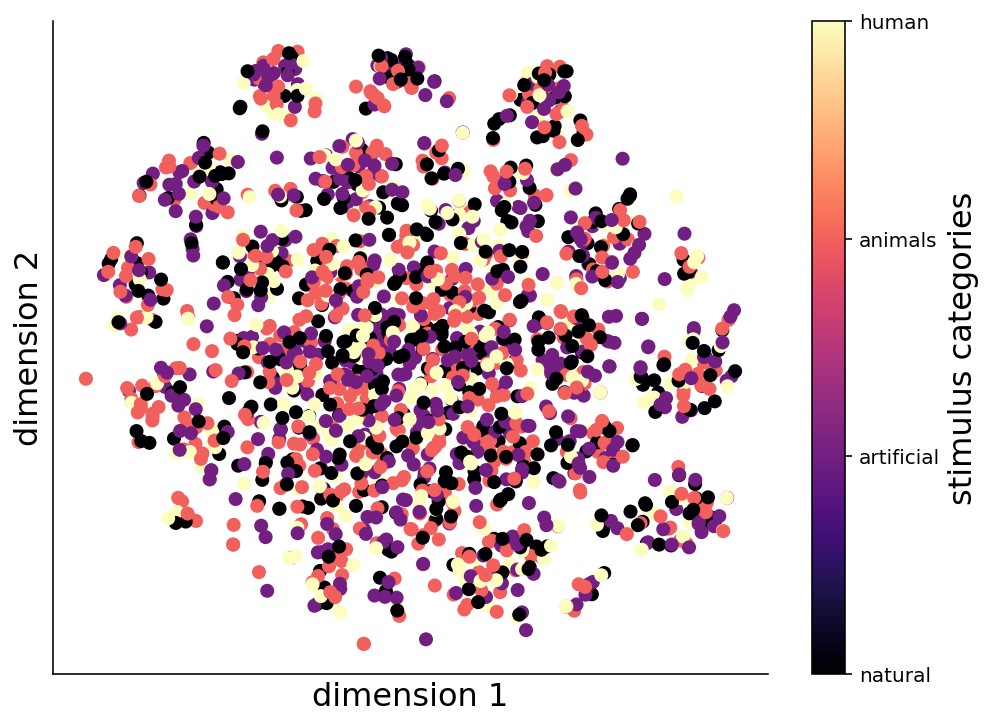

In [14]:
plot_dim_reduction(V4_response, training_labels)

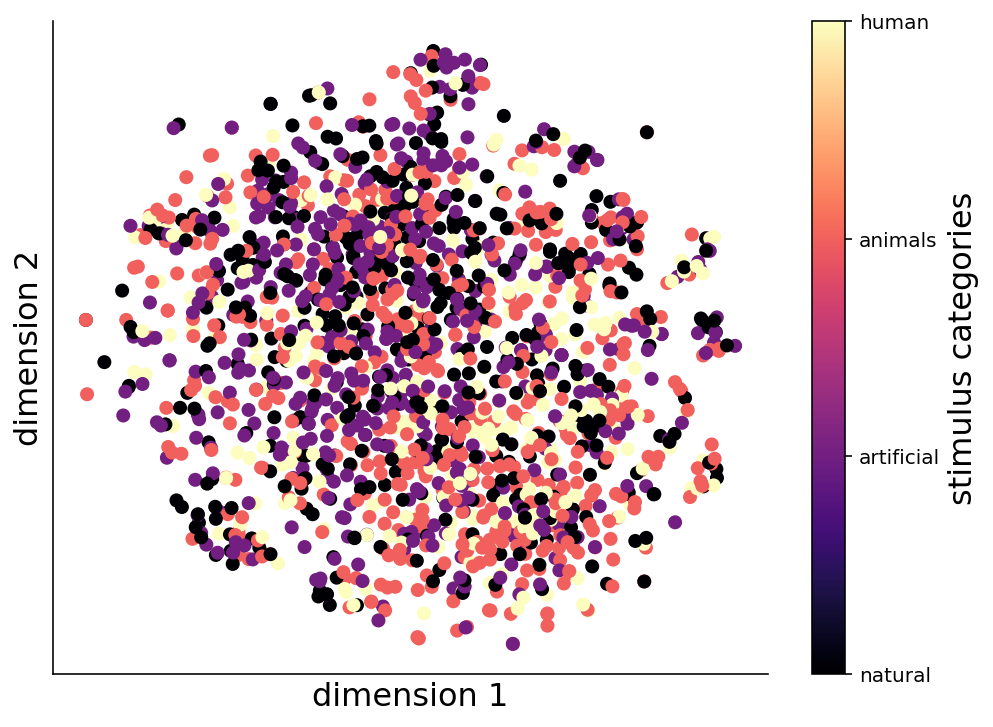

In [15]:
plot_dim_reduction(LatOcc_response, training_labels)

## RDM
RDM 我写了两种方法，一种是用相关算的，一种用距离算的。

In [16]:
sort_idx = np.argsort(training_labels) # 按照我们分的labels sort

['natural', 'artificial', 'animals', 'human']

In [159]:
def plot_corr_matrix(rdm, ax=None, vmax=2.0, title=None):
    """Plot dissimilarity matrix

    Args:
      rdm (numpy array): n_stimuli x n_stimuli representational dissimilarity 
        matrix
      ax (matplotlib axes): axes onto which to plot

    Returns:
      nothing
    
    """
    if ax is None:
      ax = plt.gca()

    cax = ax.imshow(rdm, vmin=0.0, vmax=vmax, cmap='YlGn') # YlOrBr YlGn YlGnBu
    ax.set_aspect('auto')
    ax.set_title(title)

    if rdm.shape[0] == 4:
        ax.set_xticks([i for i in range(4)])
        ax.set_yticks([i for i in list(range(4))[::-1]])
        ax_label = [str(i).split('_')[1] for i in list(labels2num.keys())]
        ax.set_xticklabels([])
        #ax.set_xticklabels([ax_label[i] for i in range(4)], rotation=10)
        ax.set_yticklabels([])
        #ax.set_yticklabels([ax_label[i] for i in list(range(4))[::-1]])
    else:
        ax.set_xticks([])
        ax.set_yticks([])
    cbar = plt.colorbar(cax, ax=ax, label='Euclidian Distance')

def RDM(resp, methods='corr'):
    """Compute the representational dissimilarity matrix (RDM)

    Args:
      resp: S x N matrix with population responses to
        each stimulus in each row
    
    Returns:
      np.ndarray: S x S representational dissimilarity matrix
    """
    if methods == 'corr':
        zresp = zscore(resp, axis=1)  # z-score responses to each stimulus
        result = 1 - (zresp @ zresp.T) / zresp.shape[1]
    elif methods == 'dist':
        # pdist just returns the upper triangle of the pairwise distance matrix
        pair_dist = pdist(resp)
        # to get the whole (20, 20) array we can use squareform
        result = squareform(pair_dist)
    return result

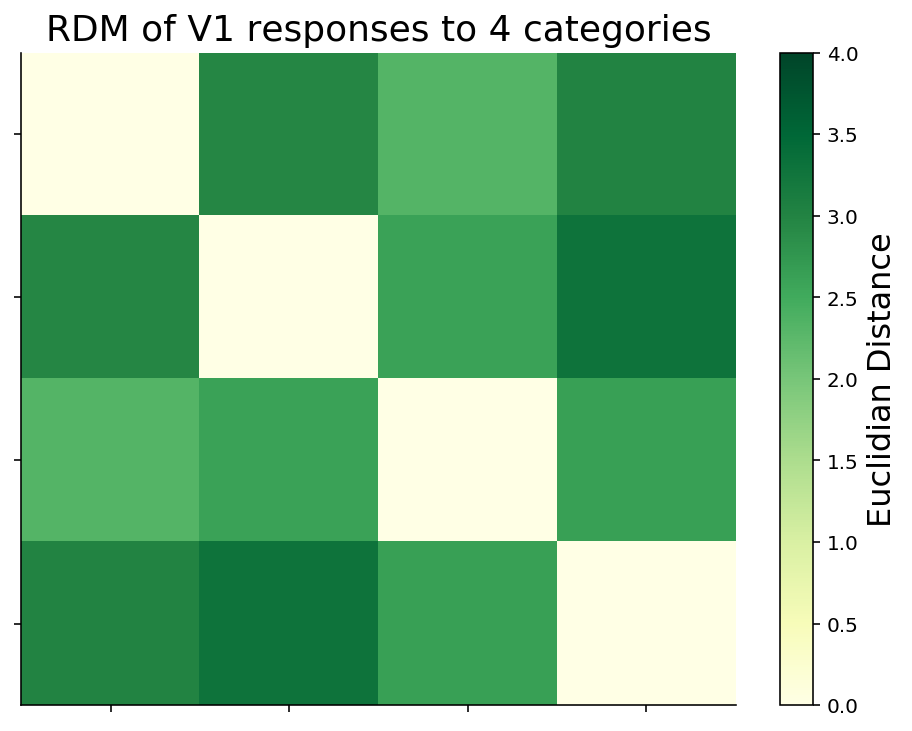

In [160]:
#@title 4分类的RDM看不出来什么
V1_RDM = RDM(V1_avg, 'dist')
plot_corr_matrix(V1_RDM, vmax=4, title='RDM of V1 responses to 4 categories')

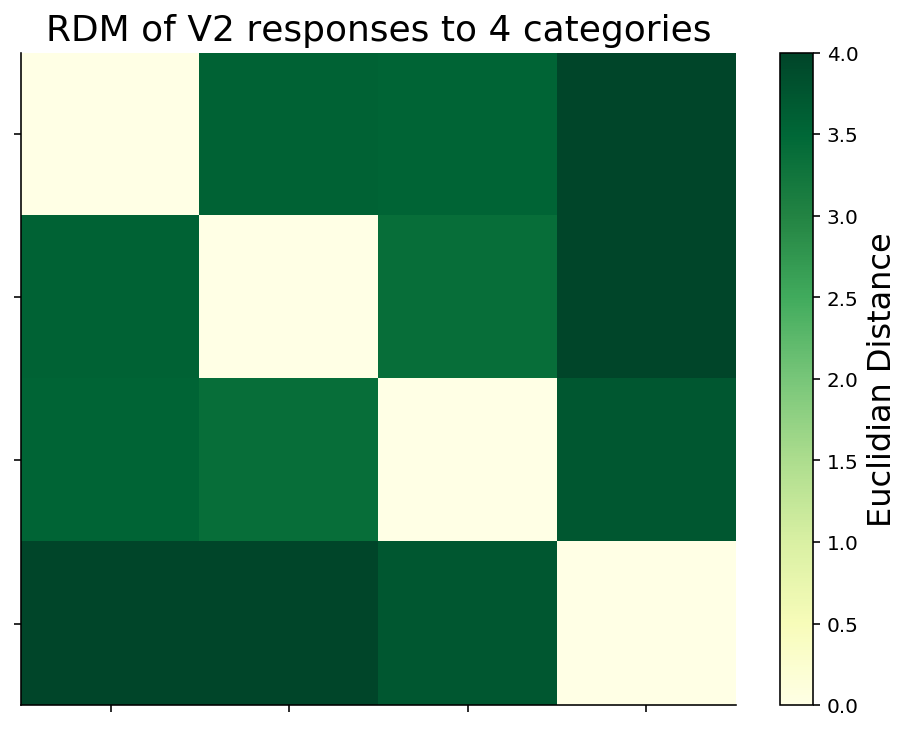

In [162]:
V2_RDM = RDM(V2_avg, 'dist')
plot_corr_matrix(V2_RDM, vmax=4, title='RDM of V2 responses to 4 categories')

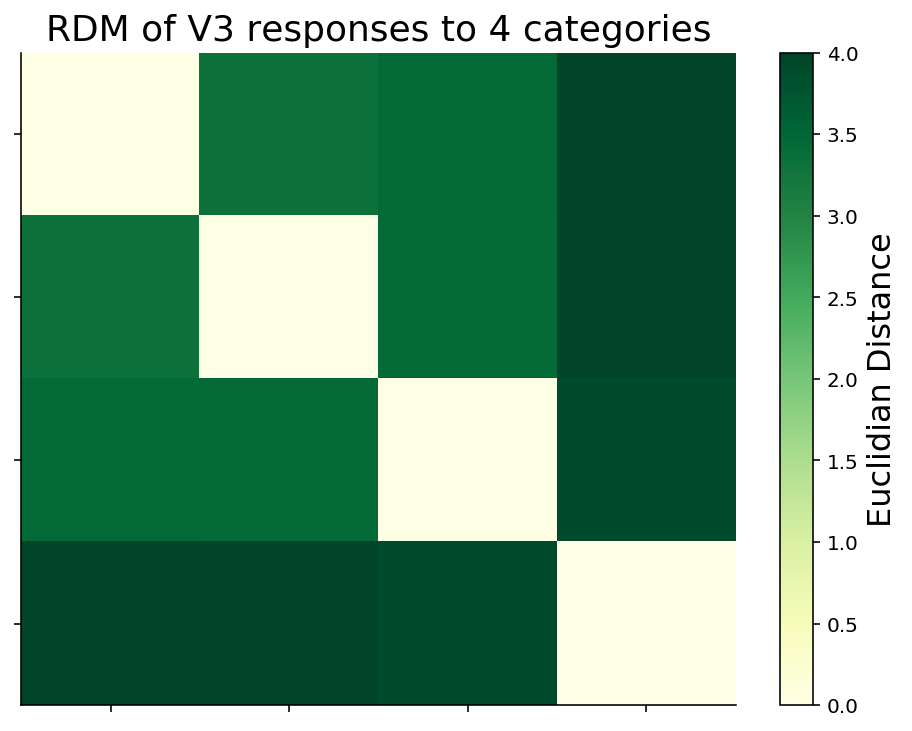

In [163]:
V3_RDM = RDM(V3_avg, 'dist')
plot_corr_matrix(V3_RDM, vmax=4, title='RDM of V3 responses to 4 categories')

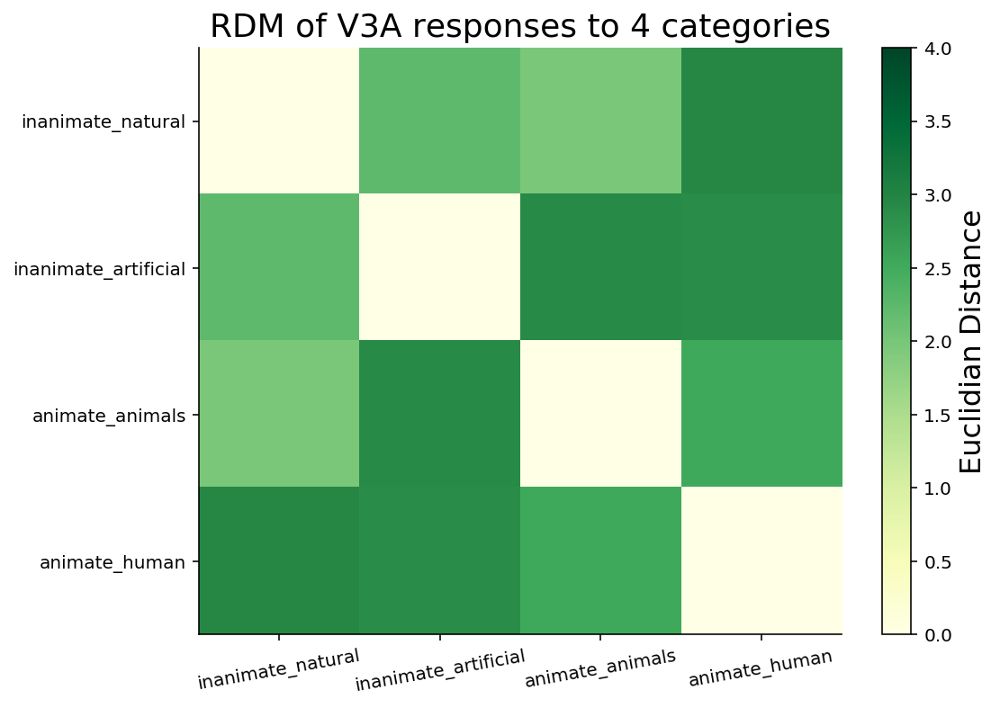

In [104]:
V3A_RDM = RDM(V3A_avg, 'dist')
plot_corr_matrix(V3A_RDM, vmax=4, title='RDM of V3A responses to 4 categories')

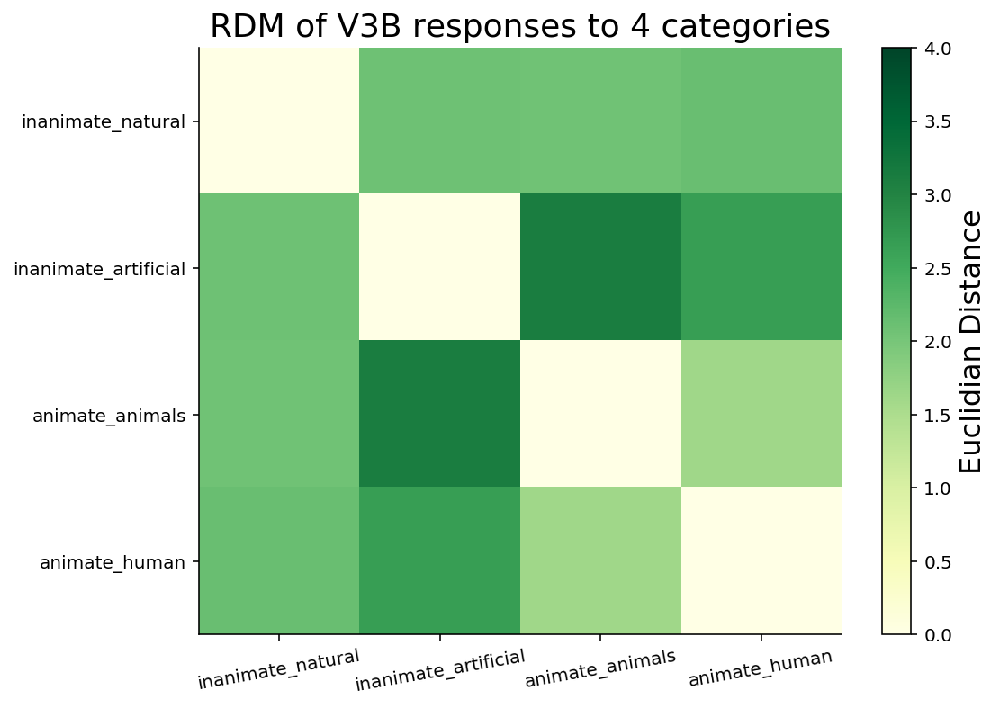

In [105]:
V3B_RDM = RDM(V3B_avg, 'dist')
plot_corr_matrix(V3B_RDM, vmax=4, title='RDM of V3B responses to 4 categories')

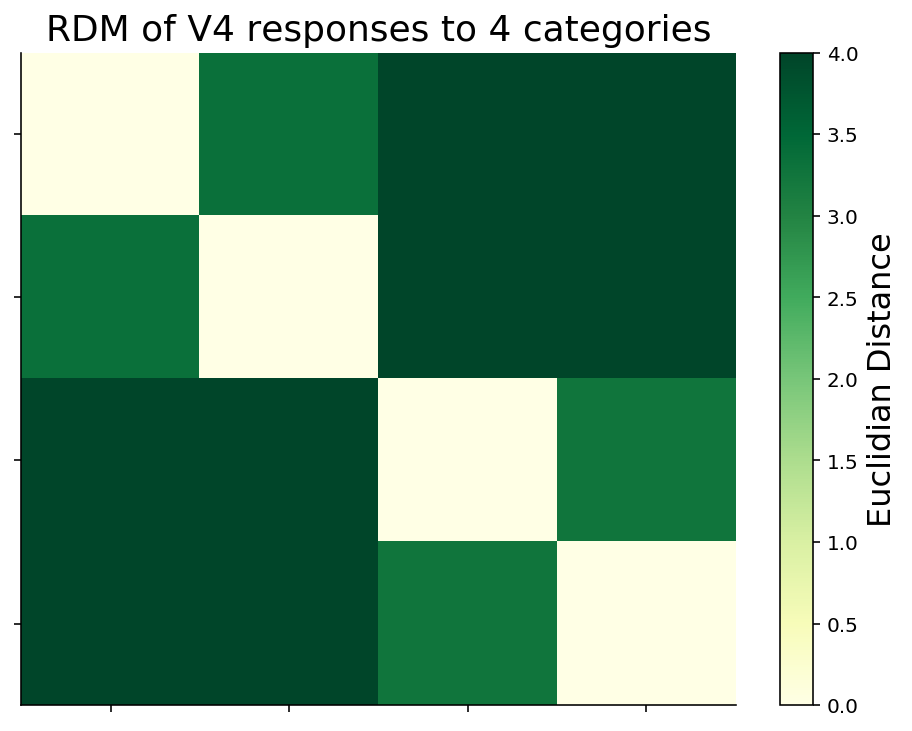

In [161]:
V4_RDM = RDM(V4_avg, 'dist')
plot_corr_matrix(V4_RDM, vmax=4, title='RDM of V4 responses to 4 categories')

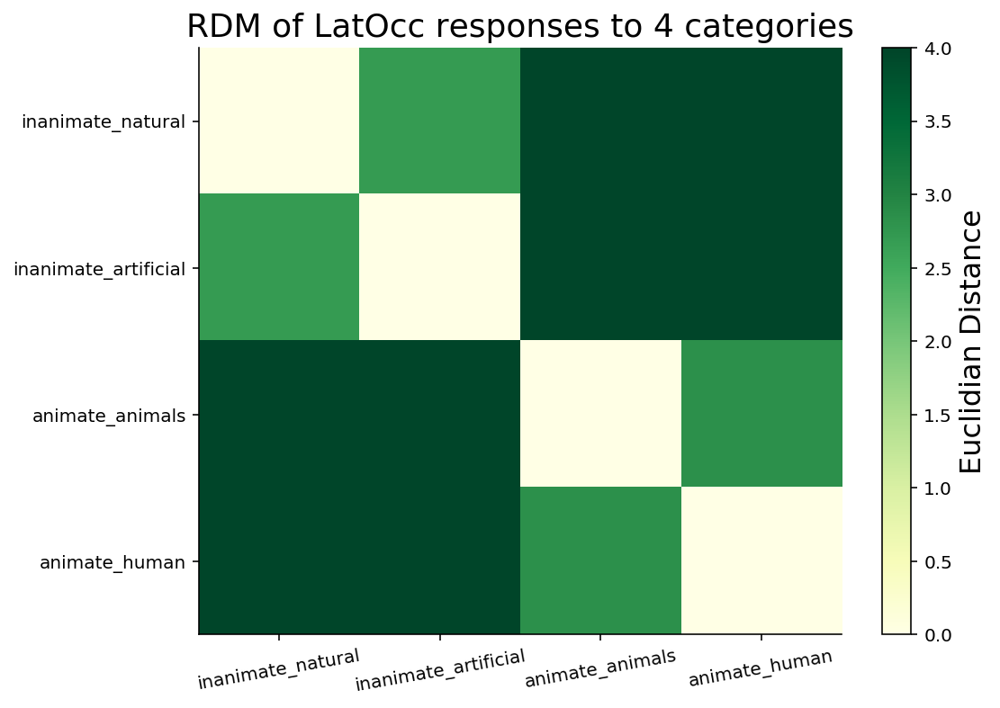

In [107]:
LatOcc_RDM = RDM(LatOcc_avg, 'dist')
plot_corr_matrix(LatOcc_RDM, vmax=4, title='RDM of LatOcc responses to 4 categories')

## 计算RDM之间的相关性

In [108]:
def corr_rdms(rdm1, rdm2):
    """Correlate off-diagonal elements of two RDM's
    Args:
    rdm1 (np.ndarray): S x S representational dissimilarity matrix
    rdm2 (np.ndarray): S x S representational dissimilarity matrix to
      correlate with rdm1

    Returns:
    float: correlation coefficient between the off-diagonal elements
      of rdm1 and rdm2

    """

    # Extract off-diagonal elements of each RDM
    ioffdiag = np.triu_indices(rdm1.shape[0], k=1)  # indices of off-diagonal elements
    rdm1_offdiag = rdm1[ioffdiag]
    rdm2_offdiag = rdm2[ioffdiag]

    # Compute correlation coefficient
    return zscore(rdm1_offdiag) @ zscore(rdm2_offdiag) / len(rdm2_offdiag)

In [109]:
all_RDM = [V1_RDM, V2_RDM, V3_RDM, V3A_RDM, V3B_RDM, V4_RDM, LatOcc_RDM]
all_RDM_corr = np.zeros([7, 7])

In [110]:
for i in range(7):
    for j in range(7):
        all_RDM_corr[i, j] = corr_rdms(all_RDM[i], all_RDM[j])

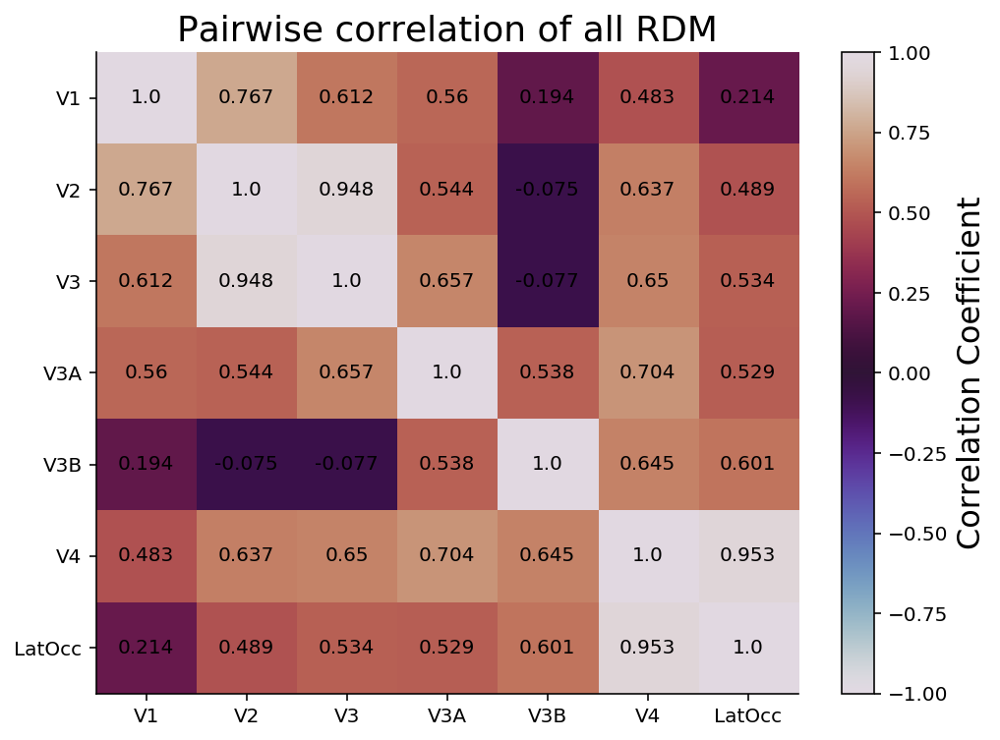

In [111]:
def plot_corr_all(rdm):
    ax = plt.gca()

    cax = ax.imshow(rdm, vmin=-1, vmax=1, cmap='twilight') # YlOrBr BuPu YlGn
    for i in range(len(rdm)):
        for j in range(len(rdm)):
            text = ax.text(j, i, round(rdm[i, j], 3),
                           ha="center", va="center", color="black")
    ax.set_aspect('auto')
    ax.set_title('Pairwise correlation of all RDM')
    ax.set_xticks([i for i in range(7)])
    ax.set_yticks([i for i in list(range(7))[::-1]])
    ax_label = dat['roi_names'][1:]
    ax.set_xticklabels([ax_label[i] for i in range(7)])
    ax.set_yticklabels([ax_label[i] for i in list(range(7))[::-1]])
    cbar = plt.colorbar(cax, ax=ax, label='Correlation Coefficient')

plot_corr_all(all_RDM_corr)

## Bold response to stimuli

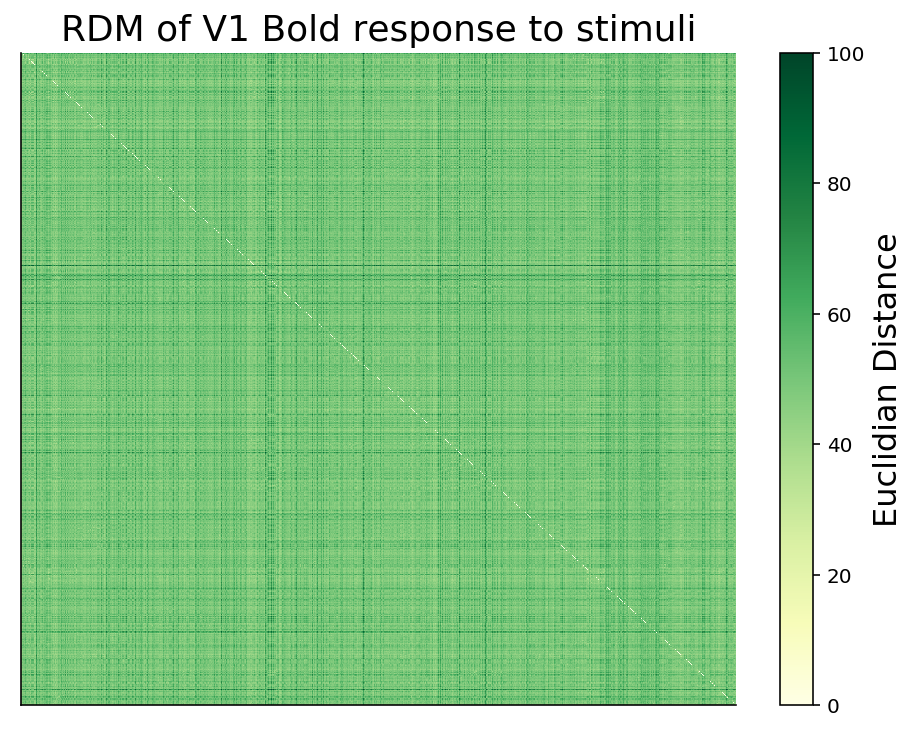

In [165]:
V1_RDM = RDM(V1_response[sort_idx], 'dist')
plot_corr_matrix(V1_RDM, vmax=100, title='RDM of V1 Bold response to stimuli')

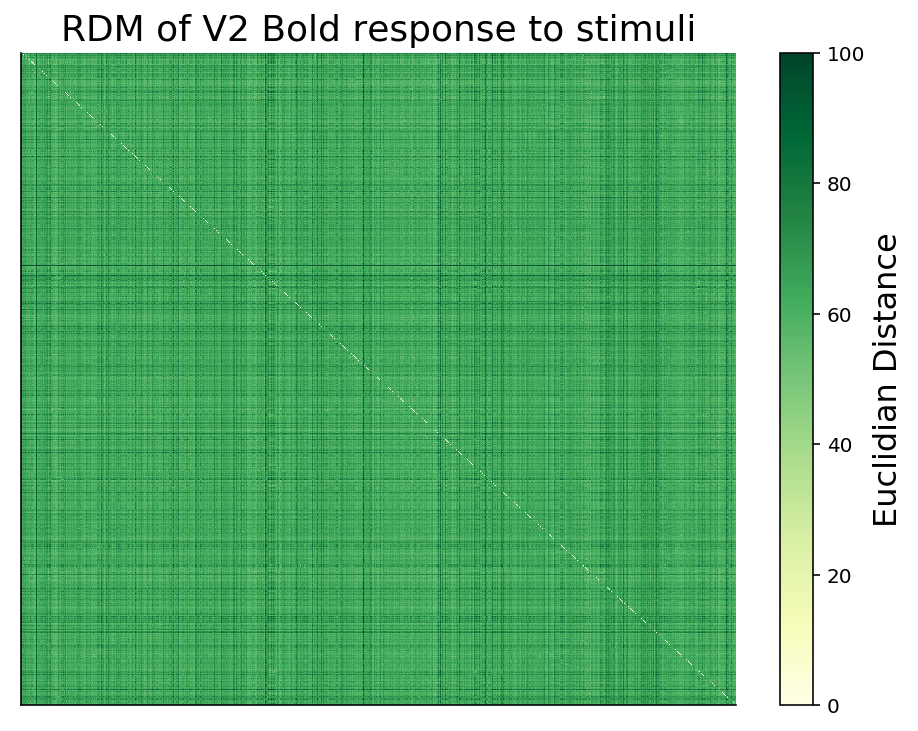

In [113]:
V2_RDM = RDM(V2_response[sort_idx], 'dist')
plot_corr_matrix(V2_RDM, vmax=100, title='RDM of V2 Bold response to stimuli')

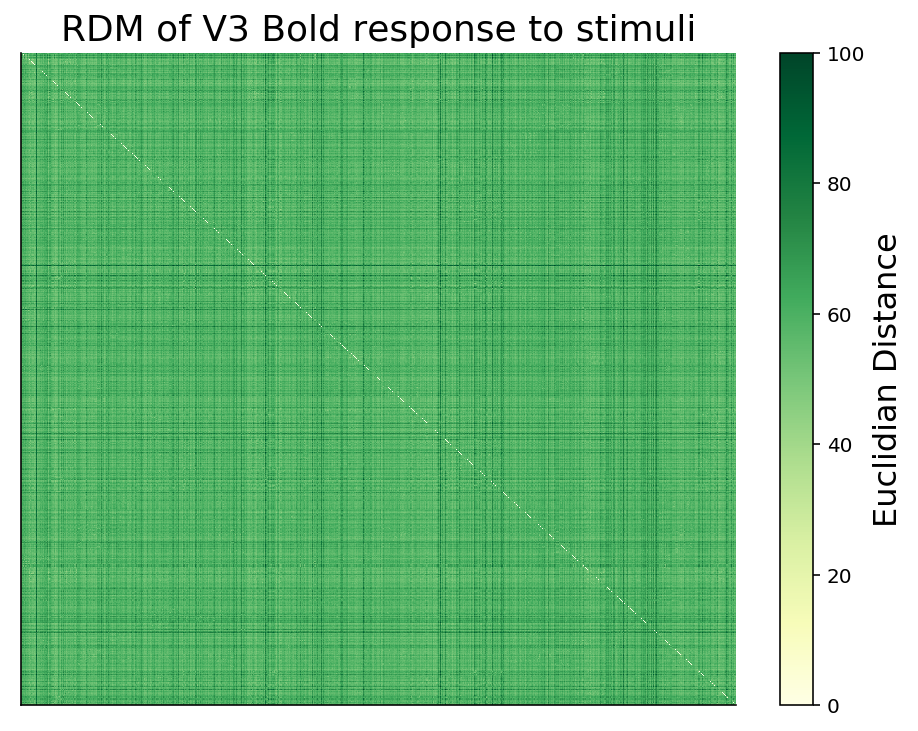

In [114]:
V3_RDM = RDM(V3_response[sort_idx], 'dist')
plot_corr_matrix(V3_RDM, vmax=100, title='RDM of V3 Bold response to stimuli')

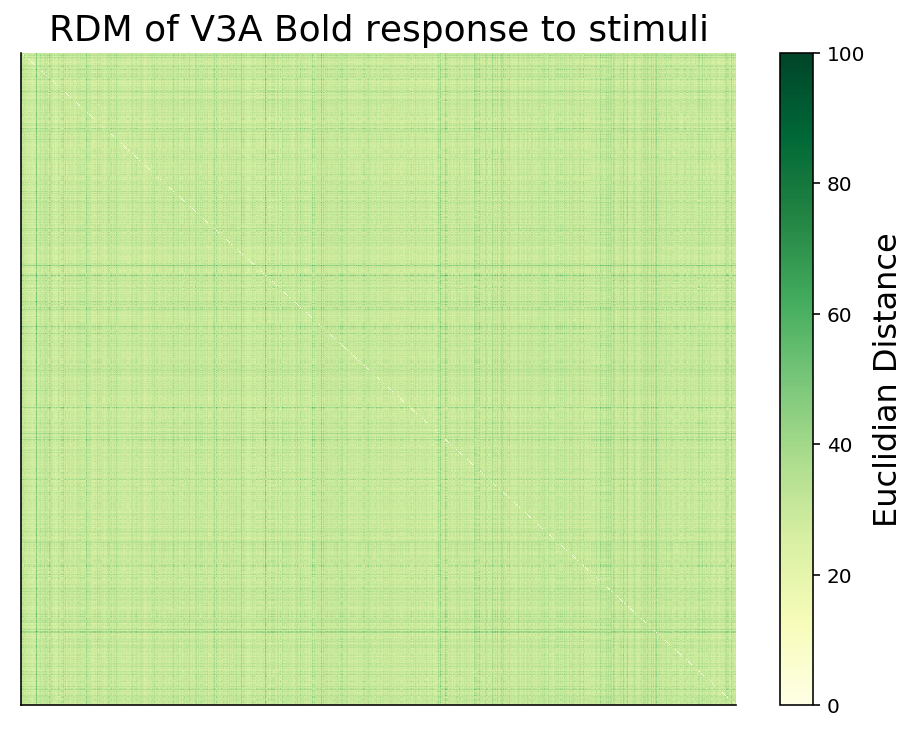

In [115]:
V3A_RDM = RDM(V3A_response[sort_idx], 'dist')
plot_corr_matrix(V3A_RDM, vmax=100, title='RDM of V3A Bold response to stimuli')

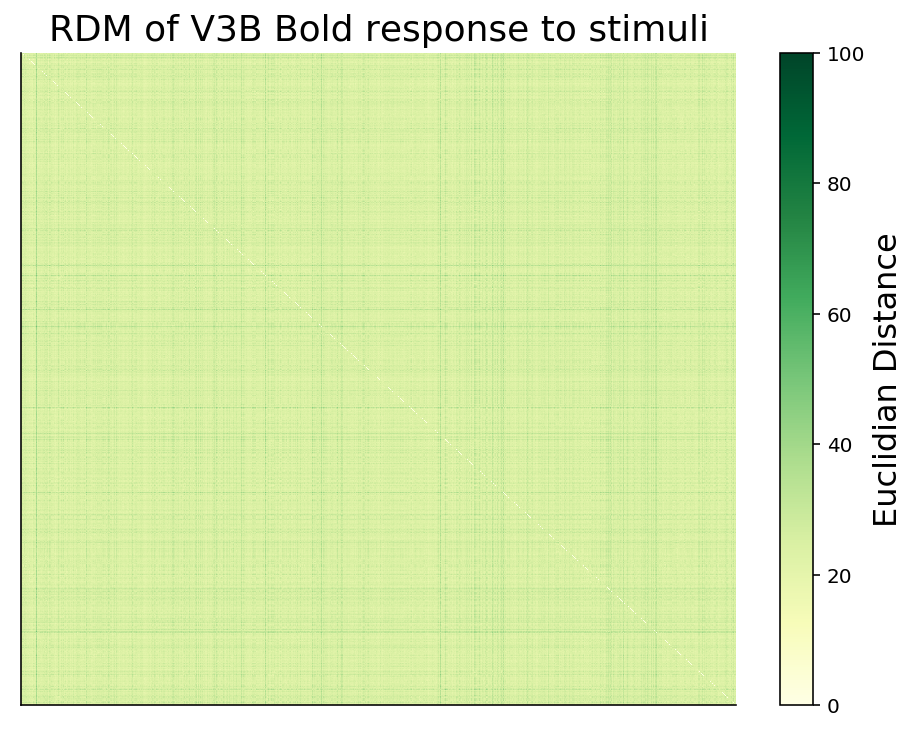

In [116]:
V3B_RDM = RDM(V3B_response[sort_idx], 'dist')
plot_corr_matrix(V3B_RDM, vmax=100, title='RDM of V3B Bold response to stimuli')

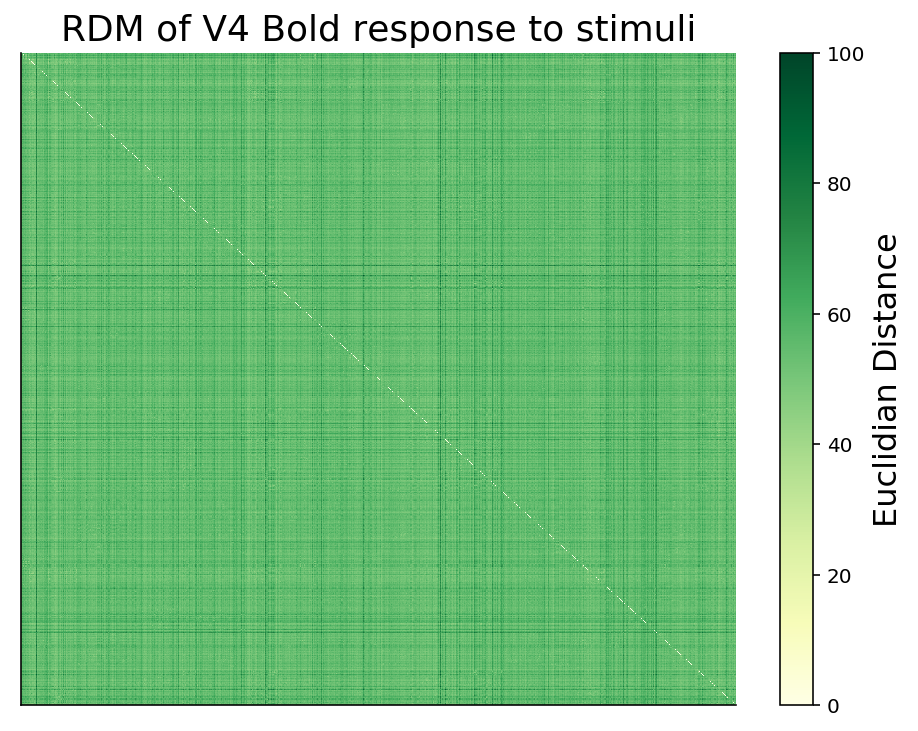

In [166]:
V4_RDM = RDM(V4_response[sort_idx], 'dist')
plot_corr_matrix(V4_RDM, vmax=100, title='RDM of V4 Bold response to stimuli')

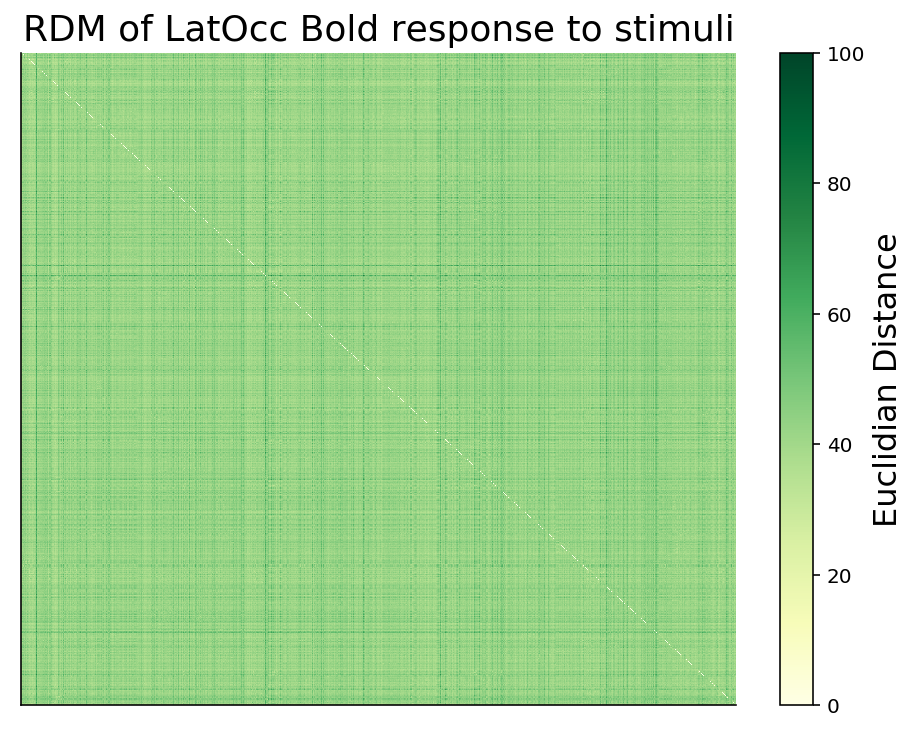

In [118]:
LatOcc_RDM = RDM(LatOcc_response[sort_idx], 'dist')
plot_corr_matrix(LatOcc_RDM, vmax=100, title='RDM of LatOcc Bold response to stimuli')

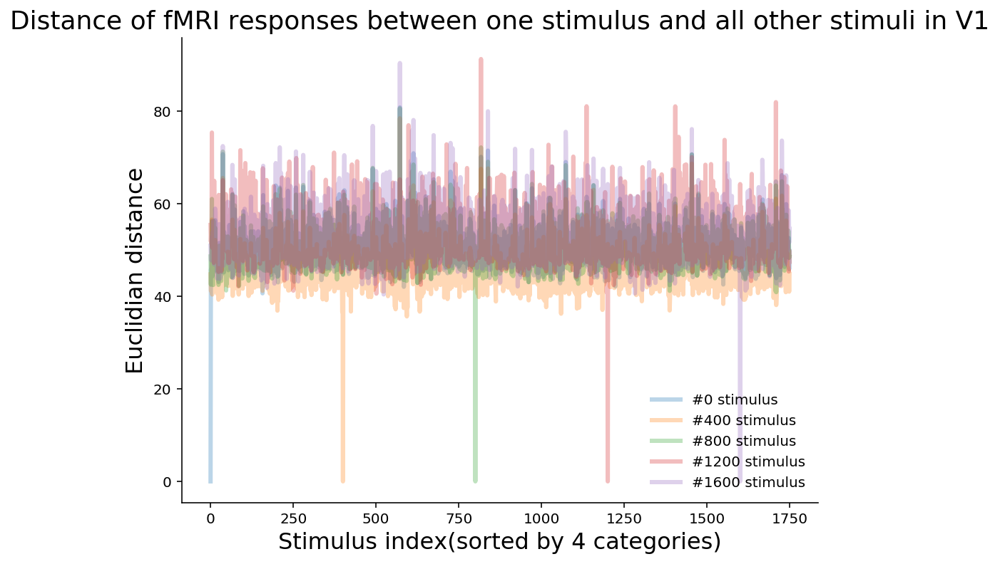

In [167]:
plt.plot(V1_RDM[0], alpha=0.3, label='#0 stimulus')
plt.plot(V1_RDM[400], alpha=0.3, label='#400 stimulus')
plt.plot(V1_RDM[800], alpha=0.3, label='#800 stimulus')
plt.plot(V1_RDM[1200], alpha=0.3, label='#1200 stimulus')
plt.plot(V1_RDM[1600], alpha=0.3, label='#1600 stimulus')
plt.title('Distance of fMRI responses between one stimulus and all other stimuli in V1')
plt.xlabel('Stimulus index(sorted by 4 categories)')
plt.ylabel('Euclidian distance')
plt.legend()

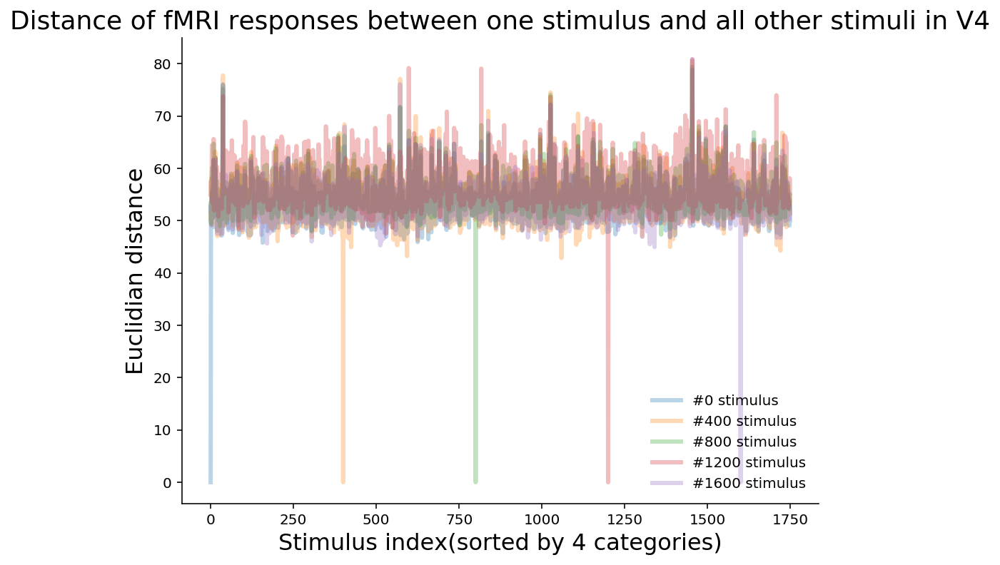

In [168]:
plt.plot(V4_RDM[0], alpha=0.3, label='#0 stimulus')
plt.plot(V4_RDM[400], alpha=0.3, label='#400 stimulus')
plt.plot(V4_RDM[800], alpha=0.3, label='#800 stimulus')
plt.plot(V4_RDM[1200], alpha=0.3, label='#1200 stimulus')
plt.plot(V4_RDM[1600], alpha=0.3, label='#1600 stimulus')
plt.title('Distance of fMRI responses between one stimulus and all other stimuli in V4')
plt.xlabel('Stimulus index(sorted by 4 categories)')
plt.ylabel('Euclidian distance')
plt.legend()

## 计算RDM之间的相关性

In [121]:
def corr_rdms(rdm1, rdm2):
    """Correlate off-diagonal elements of two RDM's
    Args:
    rdm1 (np.ndarray): S x S representational dissimilarity matrix
    rdm2 (np.ndarray): S x S representational dissimilarity matrix to
      correlate with rdm1

    Returns:
    float: correlation coefficient between the off-diagonal elements
      of rdm1 and rdm2

    """

    # Extract off-diagonal elements of each RDM
    ioffdiag = np.triu_indices(rdm1.shape[0], k=1)  # indices of off-diagonal elements
    rdm1_offdiag = rdm1[ioffdiag]
    rdm2_offdiag = rdm2[ioffdiag]

    # Compute correlation coefficient
    return zscore(rdm1_offdiag) @ zscore(rdm2_offdiag) / len(rdm2_offdiag)

In [122]:
all_RDM = [V1_RDM, V2_RDM, V3_RDM, V3A_RDM, V3B_RDM, V4_RDM, LatOcc_RDM]
all_RDM_corr = np.zeros([7, 7])

In [123]:
for i in range(7):
    for j in range(7):
        all_RDM_corr[i, j] = corr_rdms(all_RDM[i], all_RDM[j])

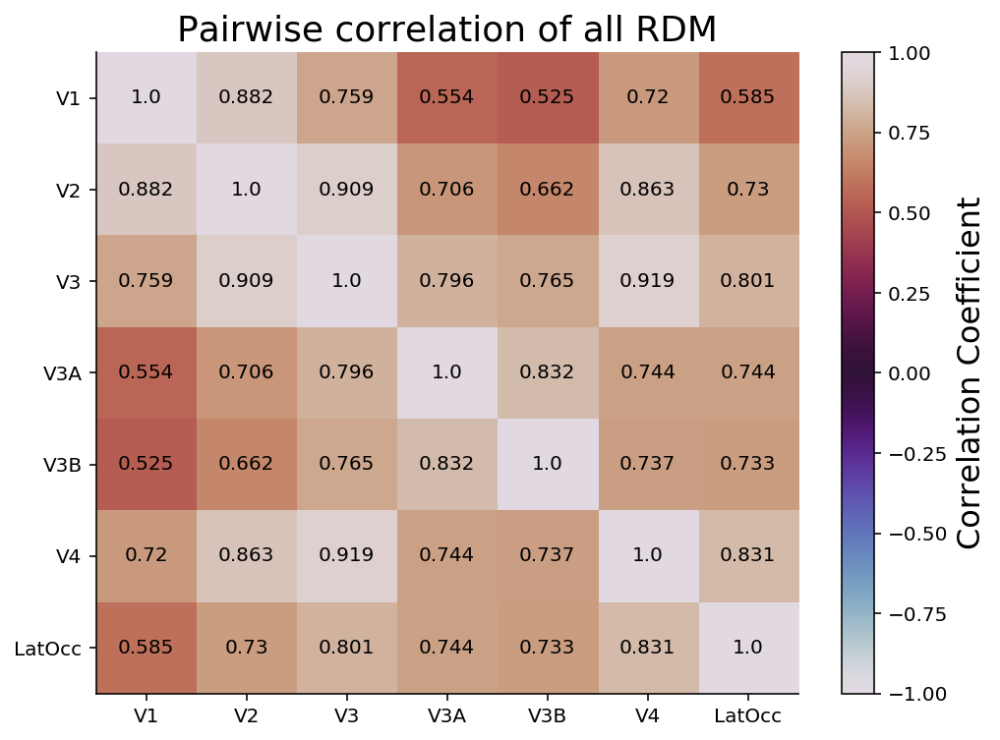

In [124]:
def plot_corr_all(rdm):
    ax = plt.gca()

    cax = ax.imshow(rdm, vmin=-1, vmax=1, cmap='twilight') # YlOrBr BuPu YlGn
    for i in range(len(rdm)):
        for j in range(len(rdm)):
            text = ax.text(j, i, round(rdm[i, j], 3),
                           ha="center", va="center", color="black")
    ax.set_aspect('auto')
    ax.set_title('Pairwise correlation of all RDM')
    ax.set_xticks([i for i in range(7)])
    ax.set_yticks([i for i in list(range(7))[::-1]])
    ax_label = dat['roi_names'][1:]
    ax.set_xticklabels([ax_label[i] for i in range(7)])
    ax.set_yticklabels([ax_label[i] for i in list(range(7))[::-1]])
    cbar = plt.colorbar(cax, ax=ax, label='Correlation Coefficient')

plot_corr_all(all_RDM_corr)

## Bold response after non-linear transformation to stimuli

In [125]:
def plot_tsne_rdm(resp, name):
    resp_lowd = PCA(n_components=min(500, resp.shape[1])).fit_transform(resp)
    resp_lowd = TSNE(n_components=2, perplexity=10, n_jobs=-1).fit_transform(resp_lowd)
    distance = RDM(resp_lowd[sort_idx], 'dist')
    plot_corr_matrix(distance, vmax=100, title='RDM of ' + name + ' Bold response to stimuli')

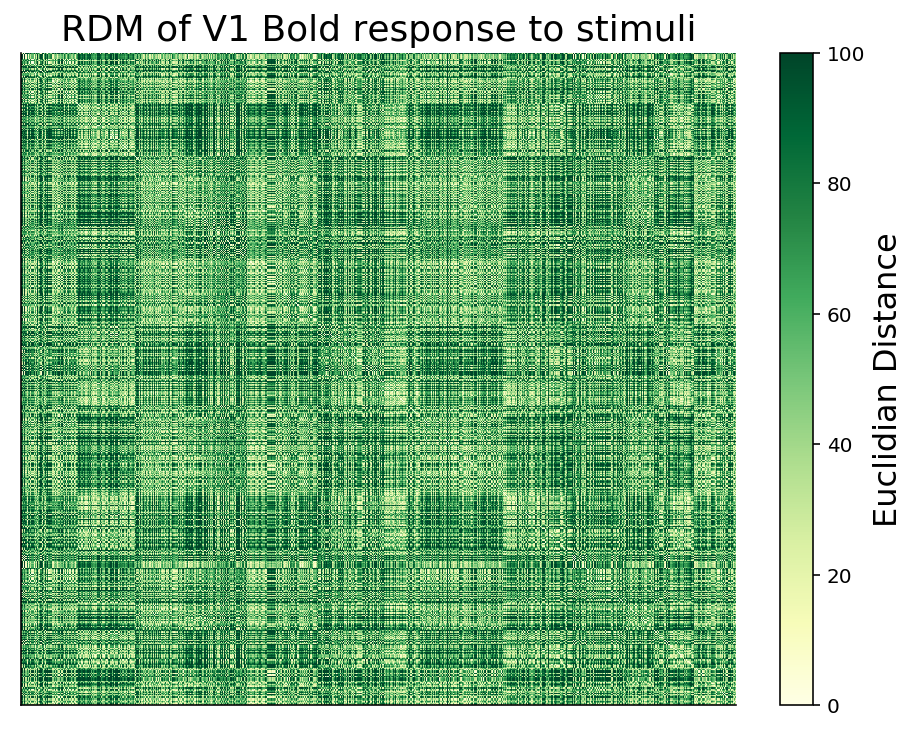

In [126]:
plot_tsne_rdm(V1_response, 'V1')

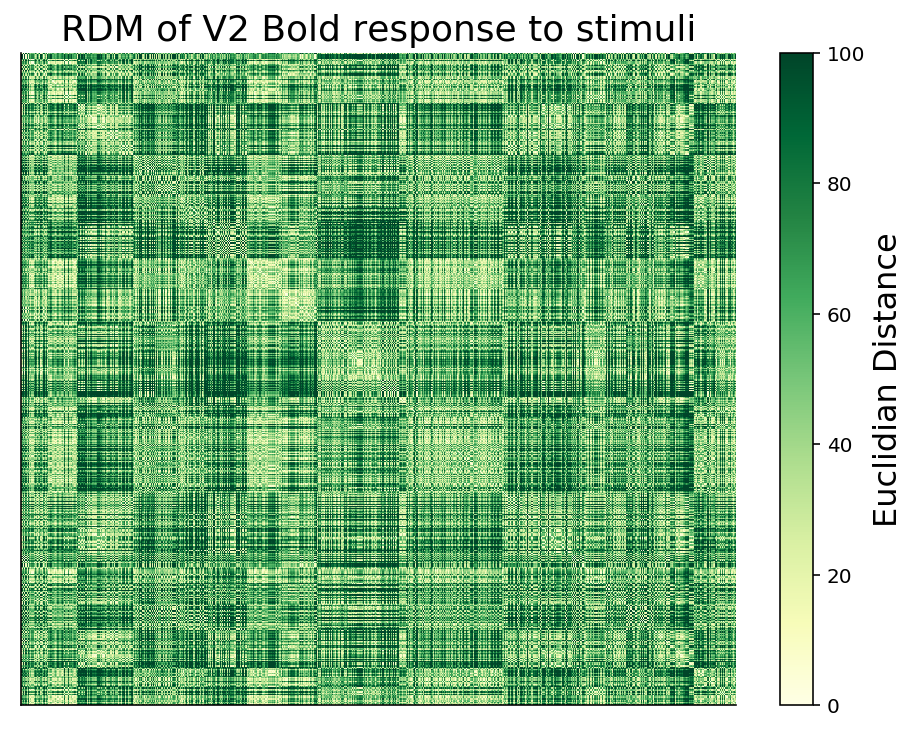

In [127]:
plot_tsne_rdm(V2_response, 'V2')

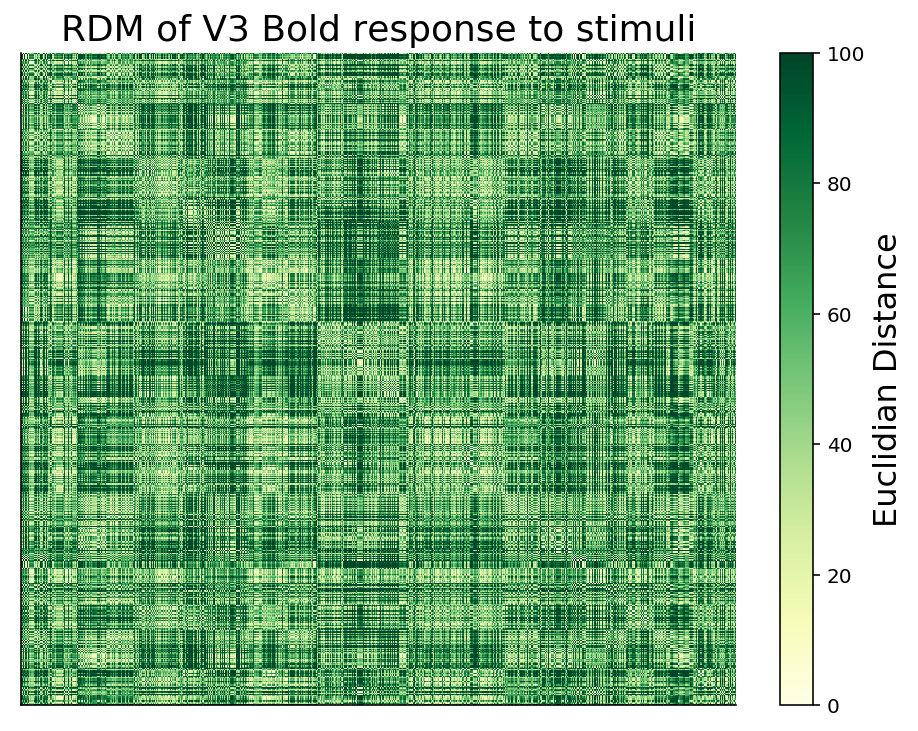

In [128]:
plot_tsne_rdm(V3_response, 'V3')

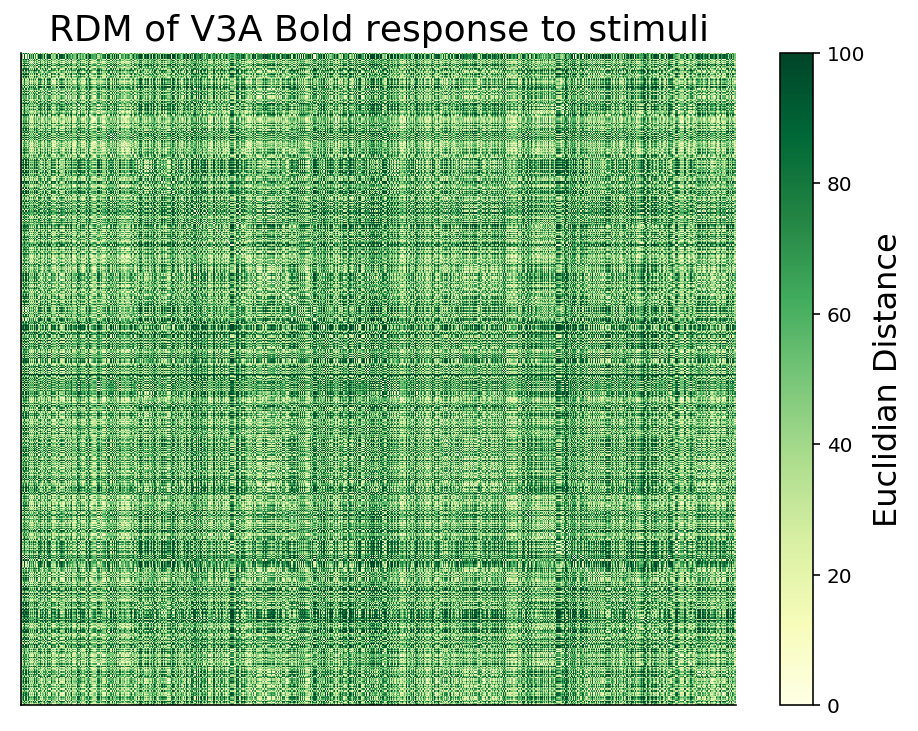

In [129]:
plot_tsne_rdm(V3A_response, 'V3A')

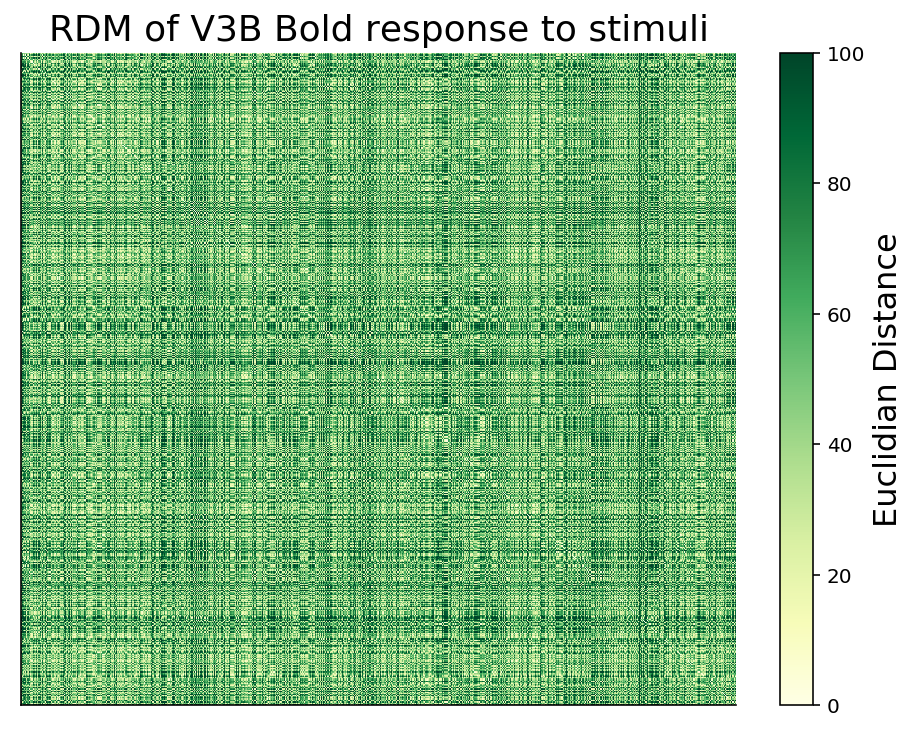

In [130]:
plot_tsne_rdm(V3B_response, 'V3B')

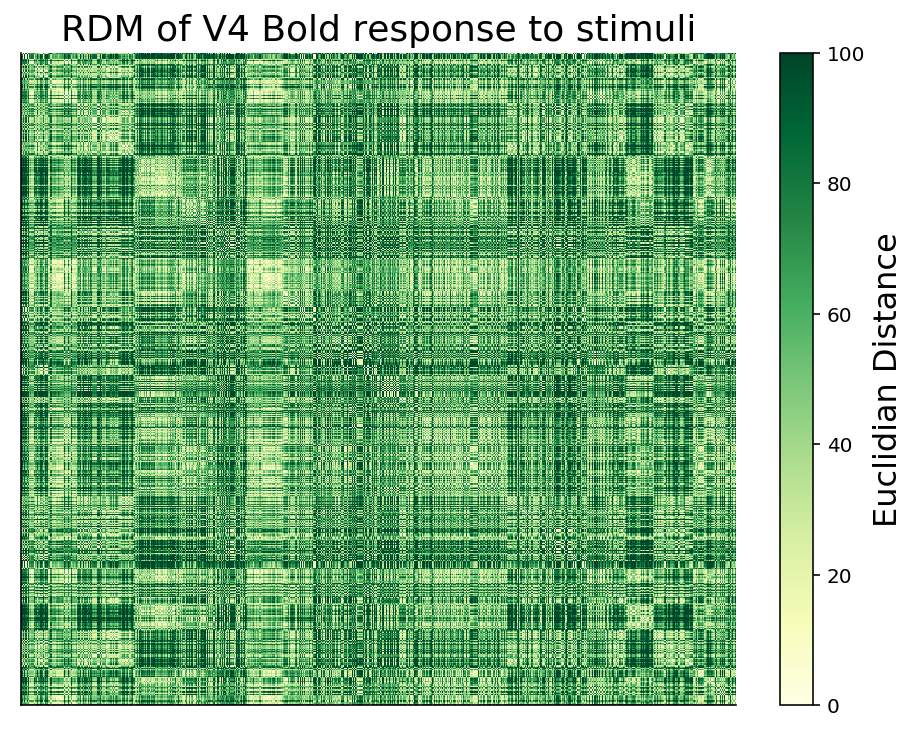

In [131]:
plot_tsne_rdm(V4_response, 'V4')

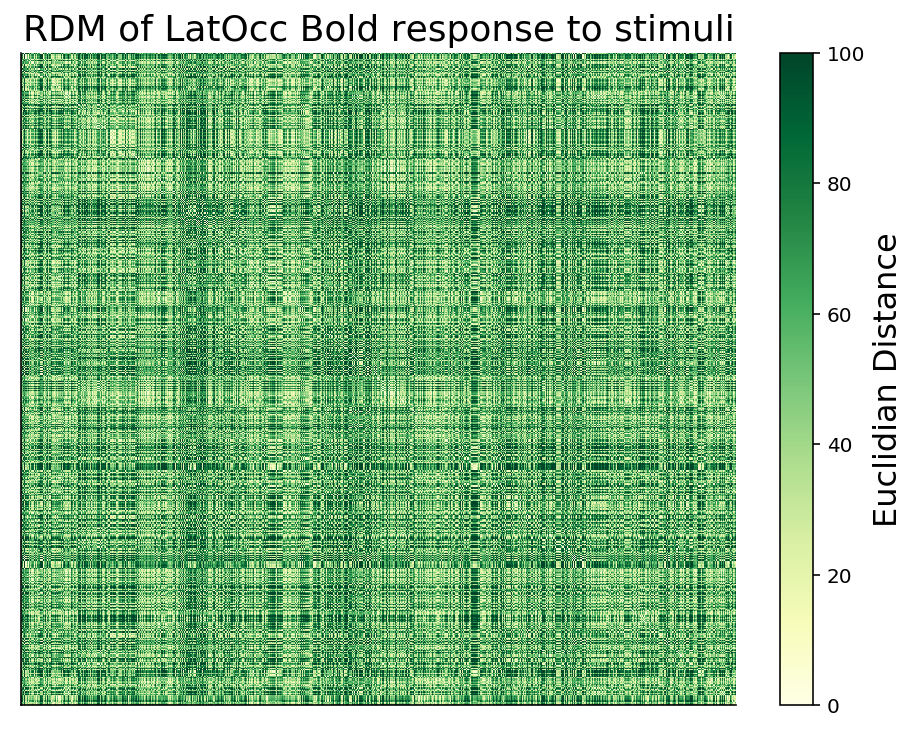

In [132]:
plot_tsne_rdm(LatOcc_response, 'LatOcc')